In [37]:
# pip install kloppy
import pandas as pd

In [38]:
from kloppy import skillcorner


matchdata_file = 'C:\\Users\\mishr\\Desktop\\fbref\\tracking data\\opendata-master\\data\\matches\\2068\\match_data.json'
tracking_file = 'C:\\Users\\mishr\\Desktop\\fbref\\tracking data\\opendata-master\\data\\matches\\2068\\structured_data.json'

dataset = skillcorner.load(meta_data=matchdata_file,
                           raw_data=tracking_file)

df = dataset.to_df()


In [307]:

import json 

f = open(matchdata_file)

matchdata = json.load(f) 

In [39]:
metadata = dataset.metadata
home_team, away_team = metadata.teams

[f"{player} ({player.jersey_no})" for player in home_team.players]


['Stefan de Vrij (6)',
 'Milan Skriniar (37)',
 "Danilo D'Ambrosio (33)",
 'Nicolo Barella (23)',
 'Matias Vecino (8)',
 'Matteo Politano (16)',
 'Alessandro Bastoni (95)',
 'Diego Godin (2)',
 'Lautaro Martinez (10)',
 'Stefano Sensi (12)',
 'Samir Handanovic (1)',
 'Sebastiano Esposito (30)',
 'Roberto Gagliardini (5)',
 'Antonio Candreva (87)',
 'Borja Valero (20)',
 'Valentino Lazaro (19)',
 'Andrea Ranocchia (13)',
 'Cristiano Biraghi (34)',
 'Federico Dimarco (21)',
 'Daniele Padelli (27)',
 'Romelu Lukaku (9)',
 'Kwadwo Asamoah (18)',
 'Marcelo Brozovic (77)']

In [43]:
first_frame = dataset.frames[0]
print(f"Number of players in the frame: {len(first_frame.players_coordinates)}")

from pprint import pprint
print("List home team players coordinates")
pprint([
    (player.player_id, player_coordinates) 
    for player, player_coordinates
    in first_frame.players_coordinates.items()
    if player.team == home_team
])

Number of players in the frame: 17
List home team players coordinates
[('home_37', Point(x=0.2863589098666667, y=0.3848519735977941)),
 ('home_23', Point(x=0.3717116394819047, y=0.798618747407353)),
 ('home_77', Point(x=0.3470991173571429, y=0.5908952956439706)),
 ('home_10', Point(x=0.4885229461046667, y=0.36753758162014705)),
 ('home_9', Point(x=0.46765683086552384, y=0.6662056235705882)),
 ('home_12', Point(x=0.4121117501031429, y=0.45445610845794115)),
 ('home_18', Point(x=0.39671847155333334, y=0.23987283826911754))]


In [44]:
for i in df.columns:
    if "home" not in i and "away" not in i:
        print(i)

period_id
timestamp
frame_id
ball_state
ball_owning_team_id
ball_x
ball_y
ball_z


In [45]:
df[12197:12200]

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_d,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s
12197,1,2269.3,24526,None,139.0,-0.000046,-0.000358,0.004316,0.065847,0.523281,...,None,None,NaN,NaN,None,None,NaN,NaN,None,None
12198,1,2269.4,24527,None,139.0,-0.000503,-0.001804,-0.014755,0.066517,0.518786,...,None,None,NaN,NaN,None,None,NaN,NaN,None,None
12199,1,2269.5,24528,None,139.0,-0.000640,-0.001819,-0.022133,0.066017,0.512912,...,None,None,NaN,NaN,None,None,NaN,NaN,None,None


In [46]:
df['home_77_d'].unique()

array([None], dtype=object)

In [47]:
def format_time(timestamp):
    minutes = int(timestamp // 60)
    seconds = int(timestamp % 60)
    formatted_time = f"{minutes:02d}:{seconds:02d}"
    return formatted_time


In [48]:
df['timestamp'].dtype

dtype('float64')

In [49]:
df['timestamp'] = df['timestamp'].astype(int)

# Create a new column with the formatted time
df['formatted_time'] = df['timestamp'].apply(format_time)


In [50]:
df[34000:]

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
34000,2,5692,72089,None,145.0,0.858613,0.011610,0.208569,0.842319,0.014820,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:52
34001,2,5692,72090,None,145.0,0.864406,0.012145,0.187167,0.845927,0.012375,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:52
34002,2,5693,72091,None,145.0,0.868207,0.019947,0.125978,0.849641,0.010217,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:53
34003,2,5693,72092,None,145.0,0.873917,0.022876,0.110106,0.854494,0.009252,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:53
34004,2,5693,72093,None,145.0,0.881367,0.021730,0.098432,0.859658,0.008075,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:53
34005,2,5693,72094,None,145.0,0.888906,0.015242,0.133390,0.864320,0.009892,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:53
34006,2,5693,72095,None,145.0,0.897874,0.004757,0.213329,0.868105,0.010457,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:53
34007,2,5693,72096,None,145.0,0.905069,-0.003939,0.216671,0.871934,0.011257,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:53
34008,2,5693,72097,None,145.0,0.909288,-0.007850,0.150787,0.874725,0.010996,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:53
34009,2,5693,72098,None,145.0,0.913849,-0.009936,0.135454,0.876919,0.009945,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:53


In [293]:
# df = df.filter(lambda col: not '_anon_' in col, axis=1)


In [294]:
# df = df.drop(columns=[col for col in df.columns if '_anon_' in col])


In [51]:
df

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
0,1,0,1833,None,NaN,NaN,NaN,NaN,0.286359,0.384852,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
1,1,0,1834,None,NaN,NaN,NaN,NaN,0.287093,0.385357,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
2,1,0,1835,None,NaN,NaN,NaN,NaN,0.287707,0.386874,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
3,1,0,1836,None,NaN,NaN,NaN,NaN,0.288795,0.389944,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
4,1,0,1837,None,NaN,NaN,NaN,NaN,0.289064,0.391465,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34014,2,5694,72103,None,139.0,0.936581,-0.020465,0.063876,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:54
34015,2,5694,72104,None,139.0,0.941653,-0.024549,0.039067,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:54
34016,2,5694,72105,None,139.0,0.946676,-0.028225,0.018283,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:54
34017,2,5694,72106,None,139.0,0.951649,-0.031491,0.001524,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:54


In [52]:
for column in df.columns:
    if '_x' in column:
        df[column] = df[column] * 105
    elif '_y' in column:
        df[column] = df[column] * 68


In [328]:
def get_goalkeeper(matchdata):

    home_team_id = matchdata['home_team']['id']
    away_team_id = matchdata['away_team']['id']

    home_gk = None
    away_gk = None
    
    for player in matchdata['players']:
        if (player['player_role']['name'] == "Goalkeeper") and (player["start_time"] == "00:00:00"):
            
            if player['team_id'] == home_team_id:
                home_gk = ("home_" + str(player['number']))
            
            else:
                away_gk = ("away_" + str(player['number']))
        
    return home_gk, away_gk



def find_playing_direction(dataframe, matchdata):
    
    home_gk, away_gk = get_goalkeeper(matchdata)
    # print(home_gk + "_x", away_gk + "_x")
    
    if ((dataframe[(dataframe['period_id'] == 1) & (dataframe[home_gk + "_x"].notna())][home_gk + "_x"].mean()) < 50) | ((dataframe[(dataframe['period_id'] == 1) & (dataframe[away_gk + "_x"].notna())][away_gk + "_x"].mean()) > 55):
    # +ve is left->right, -ve is right->left
    # home team attacking from left to right in the first half
        return 1
    
    else:
        return -1


def to_single_playing_direction(dataframe,first_half_direction_flag):
    '''
    Flip coordinates in second half so that each team always shoots in the same direction through the match.
    '''

    dataframe_copy = dataframe.copy()
    columns_to_flip = [c for c in dataframe_copy.columns if c[-1].lower() in ['x','y']]

    if first_half_direction_flag == 1:
        conditions = (dataframe_copy['period_id'] == 2)

    else:
        conditions = (dataframe_copy['period_id'] == 1)

    for column in columns_to_flip:
        # conditions &= (~dataframe_copy[column].isna())

        if column[-1] == "x":
            dataframe_copy.loc[conditions, column] = 105 - dataframe_copy.loc[conditions, column]

        else:
            dataframe_copy.loc[conditions, column] = 68 - dataframe_copy.loc[conditions, column]


    return dataframe_copy

In [329]:
new_Df = to_single_playing_direction(df, find_playing_direction(df, matchdata))

In [53]:
df[((df["timestamp"] < 2710) & (df["timestamp"] >= 2709))]

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
15268,1,2709,28923,None,139.0,NaN,NaN,NaN,11.610354,31.552280,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09
15269,1,2709,28924,None,139.0,NaN,NaN,NaN,11.662447,31.436429,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09
16028,2,2709,42251,None,145.0,103.286100,22.344254,NaN,88.139664,53.118353,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09
16029,2,2709,42252,None,145.0,102.927726,20.921396,-0.013224,88.299638,52.888163,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09
16030,2,2709,42253,None,145.0,102.616049,19.552582,0.007448,88.483814,52.560911,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09
16031,2,2709,42254,None,145.0,102.296812,18.461206,0.039594,88.670264,52.262348,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09
16032,2,2709,42255,None,145.0,101.864334,17.522713,0.101812,88.818250,51.992410,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09
16033,2,2709,42256,None,145.0,101.534639,16.687971,0.135573,88.905725,51.812671,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09
16034,2,2709,42257,None,145.0,101.205369,15.850669,0.165644,89.055040,51.566297,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09
16035,2,2709,42258,None,145.0,101.026496,14.912196,0.171994,89.198418,51.289902,...,None,NaN,NaN,None,None,NaN,NaN,None,None,45:09


In [54]:
df

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
0,1,0,1833,None,NaN,NaN,NaN,NaN,30.067686,26.169934,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
1,1,0,1834,None,NaN,NaN,NaN,NaN,30.144773,26.204255,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
2,1,0,1835,None,NaN,NaN,NaN,NaN,30.209257,26.307451,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
3,1,0,1836,None,NaN,NaN,NaN,NaN,30.323431,26.516166,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
4,1,0,1837,None,NaN,NaN,NaN,NaN,30.351717,26.619590,...,None,NaN,NaN,None,None,NaN,NaN,None,None,00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34014,2,5694,72103,None,139.0,98.340972,-1.391651,0.063876,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:54
34015,2,5694,72104,None,139.0,98.873551,-1.669364,0.039067,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:54
34016,2,5694,72105,None,139.0,99.400937,-1.919271,0.018283,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:54
34017,2,5694,72106,None,139.0,99.923129,-2.141374,0.001524,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,94:54


In [32]:
df['frame_id'] == 54166

False

In [176]:
df.iloc[32381:32441]

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
32381,2,5373,68900,None,145.0,14.998030,57.491216,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:33
32382,2,5374,68901,None,145.0,15.322384,57.298253,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:34
32383,2,5374,68902,None,145.0,15.605673,57.078676,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:34
32384,2,5374,68903,None,145.0,15.850583,56.894613,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:34
32385,2,5374,68904,None,145.0,16.077271,56.701196,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:34
32386,2,5374,68905,None,145.0,16.313323,56.605356,-0.030232,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:34
32387,2,5374,68906,None,145.0,16.460863,56.366265,-0.041799,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:34
32388,2,5374,68907,None,145.0,16.510981,55.987867,0.069029,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:34
32389,2,5374,68908,None,145.0,16.440636,55.543145,0.401073,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:34
32390,2,5374,68909,None,145.0,16.257988,54.996782,0.900932,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:34


In [165]:
out_of_pitch = df[((df["ball_x"] < 0) | (df["ball_x"] > 105)) & ~(((df["ball_y"].between(30.34, 37.66)) & (df["ball_z"] < 2.44)) | (df["ball_z"].isna()))]

out_of_pitch

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
7865,1,1470,16541,None,139.0,-0.028831,51.020785,0.227773,6.703821,38.160302,...,None,NaN,NaN,None,None,NaN,NaN,None,None,24:30
7866,1,1470,16542,None,139.0,-0.190541,50.245992,0.159737,6.705221,38.091253,...,None,NaN,NaN,None,None,NaN,NaN,None,None,24:30
7867,1,1471,16543,None,139.0,-0.345043,49.419168,0.095886,6.676922,38.060412,...,None,NaN,NaN,None,None,NaN,NaN,None,None,24:31
7868,1,1471,16544,None,139.0,-0.520170,48.641482,0.047866,6.594844,38.074351,...,None,NaN,NaN,None,None,NaN,NaN,None,None,24:31
7869,1,1471,16545,None,139.0,-0.608993,47.896551,0.004810,6.439646,37.902906,...,None,NaN,NaN,None,None,NaN,NaN,None,None,24:31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31884,2,5319,68359,None,145.0,-0.549849,2.058181,2.352147,6.038638,30.591445,...,None,NaN,NaN,None,None,NaN,NaN,None,None,88:39
32422,2,5378,68941,None,145.0,-0.123674,59.076924,0.862847,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:38
33554,2,5573,70896,None,145.0,-0.706429,39.110667,0.121760,9.266737,30.921255,...,None,NaN,NaN,None,None,NaN,NaN,None,None,92:53
33555,2,5573,70897,None,145.0,-2.070280,38.592223,0.213607,9.114472,30.695271,...,None,NaN,NaN,None,None,NaN,NaN,None,None,92:53


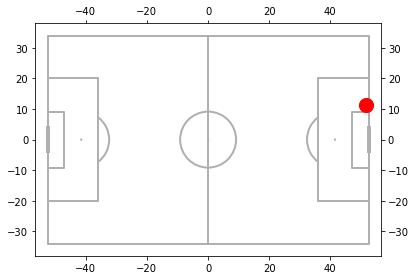

In [19]:
import matplotlib.pyplot as plt

from mplsoccer import Pitch, VerticalPitch
pitch = Pitch(pitch_type='skillcorner', pitch_length =105, pitch_width = 68, axis=True, label=True, tick=True)
fig, ax = pitch.draw()


pitch.scatter(51.64305, 11.172127,color='red',marker="o",ax=ax,zorder=3,s=200)






In [77]:
df[df['frame_id'] == 54141]

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
23496,2,3898,54141,None,145.0,NaN,NaN,NaN,1.960408,38.986917,...,None,NaN,NaN,None,None,NaN,NaN,None,None,64:58


In [155]:
df[12115:12145]

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
12115,1,2246,24298,None,145.0,0.819714,12.514576,2.902440e-16,7.802490,4.920927,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:26
12116,1,2246,24299,None,145.0,0.400235,12.279876,1.451220e-16,7.704195,5.036659,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:26
12117,1,2246,24300,None,145.0,0.000036,12.053271,-2.418700e-16,7.618702,5.206636,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:26
12118,1,2246,24301,None,145.0,-0.399601,11.832787,5.804880e-16,7.499690,5.261065,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:26
12119,1,2246,24302,None,145.0,-0.774751,11.660209,6.772360e-16,7.319812,5.272100,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:26
12120,1,2247,24303,None,145.0,-1.134204,11.478661,5.804880e-16,7.131825,5.285177,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:27
12121,1,2247,24304,None,145.0,-1.533319,11.232358,2.902440e-16,6.944534,5.311648,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:27
12122,1,2247,24305,None,145.0,-1.878552,11.034749,-1.934960e-16,6.813954,5.365831,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:27
12123,1,2247,24306,None,145.0,-2.266073,10.823428,NaN,6.671532,5.419828,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:27
12124,1,2247,24307,None,145.0,-2.662648,10.531106,-1.934960e-16,6.553447,5.489531,...,None,NaN,NaN,None,None,NaN,NaN,None,None,37:27


In [157]:
df[25369:25380]

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
25369,2,4169,56851,None,145.0,0.238982,-0.982894,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:29
25370,2,4169,56852,None,145.0,0.052890,-0.836785,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:29
25371,2,4169,56853,None,145.0,-0.136394,-0.650999,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:29
25372,2,4169,56854,None,145.0,-0.317461,-0.507008,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:29
25373,2,4169,56855,None,145.0,-0.476647,-0.305853,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:29
25374,2,4169,56856,None,145.0,-0.614494,-0.135316,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:29
25375,2,4169,56857,None,145.0,-0.756649,0.043150,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:29
25376,2,4169,56858,None,145.0,-0.889994,0.228329,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:29
25377,2,4169,56859,None,145.0,-1.014529,0.420220,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:29
25378,2,4179,56953,None,145.0,NaN,NaN,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,69:39


In [78]:
df.columns

Index(['period_id', 'timestamp', 'frame_id', 'ball_state',
       'ball_owning_team_id', 'ball_x', 'ball_y', 'ball_z', 'home_37_x',
       'home_37_y',
       ...
       'away_anon_10663_s', 'away_anon_10674_x', 'away_anon_10674_y',
       'away_anon_10674_d', 'away_anon_10674_s', 'away_anon_10673_x',
       'away_anon_10673_y', 'away_anon_10673_d', 'away_anon_10673_s',
       'formatted_time'],
      dtype='object', length=2537)

In [314]:
new_Df[new_Df['frame_id'] == 69025]

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
32443,2,5386,69025,None,145.0,96.30911,9.847506,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:46


In [315]:
df[df['frame_id'] == 69025]

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
32443,2,5386,69025,None,145.0,8.69089,58.152494,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,89:46


In [149]:


list_df = [df.iloc[12255]]


In [150]:
list_df

[period_id                  1
 timestamp               2275
 frame_id               24584
 ball_state              None
 ball_owning_team_id    139.0
                        ...  
 away_anon_10673_x        NaN
 away_anon_10673_y        NaN
 away_anon_10673_d       None
 away_anon_10673_s       None
 formatted_time         37:55
 Name: 12255, Length: 2537, dtype: object]

In [333]:
new_Df.iloc[32443]

period_id                  2
timestamp               5386
frame_id               69025
ball_state              None
ball_owning_team_id    145.0
                       ...  
away_anon_10673_x        NaN
away_anon_10673_y        NaN
away_anon_10673_d       None
away_anon_10673_s       None
formatted_time         89:46
Name: 32443, Length: 2537, dtype: object

c:\Users\mishr\anaconda3\lib\site-packages\mplsoccer\_pitch_base.py:427: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize,


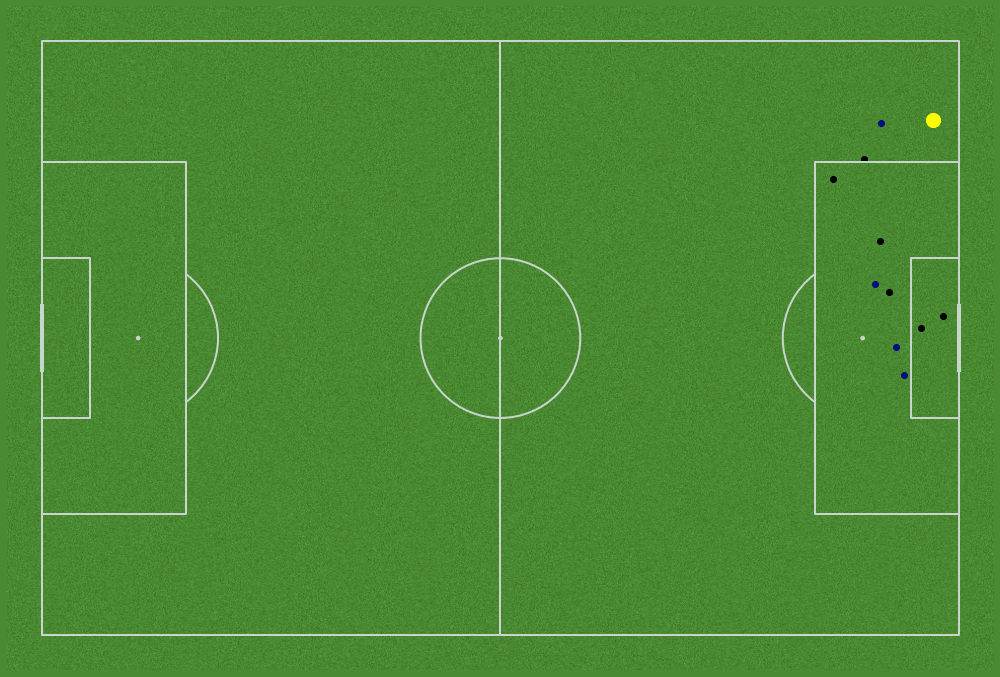

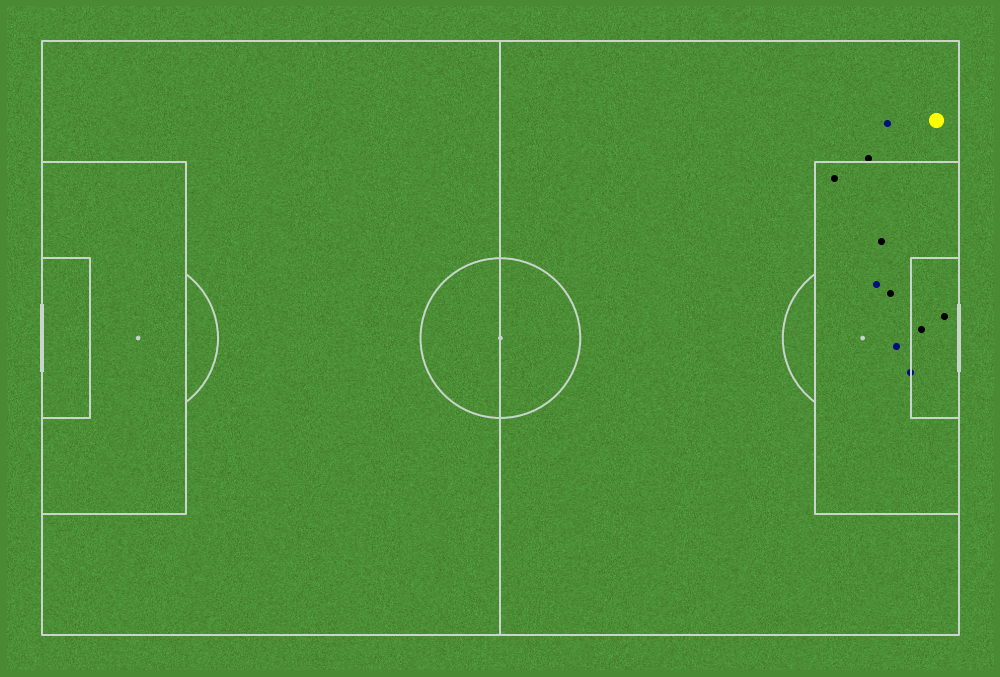

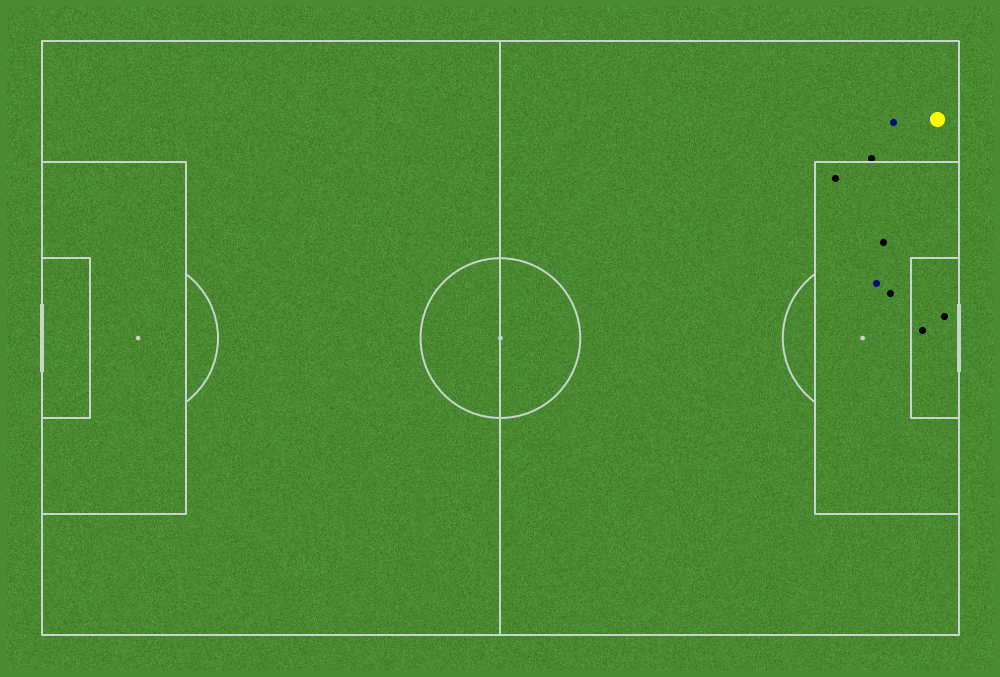

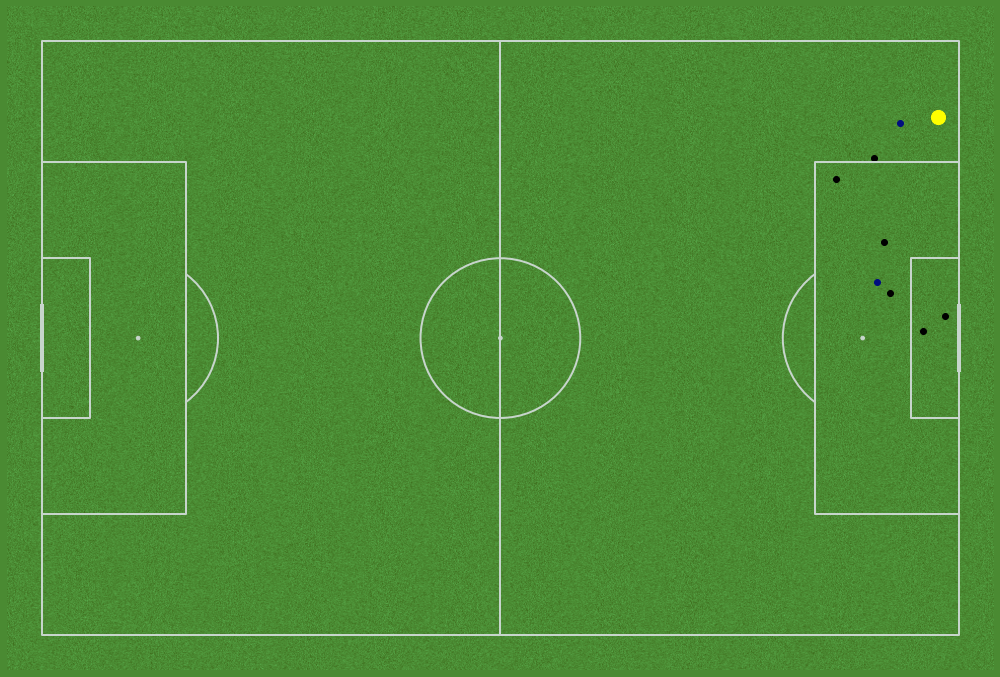

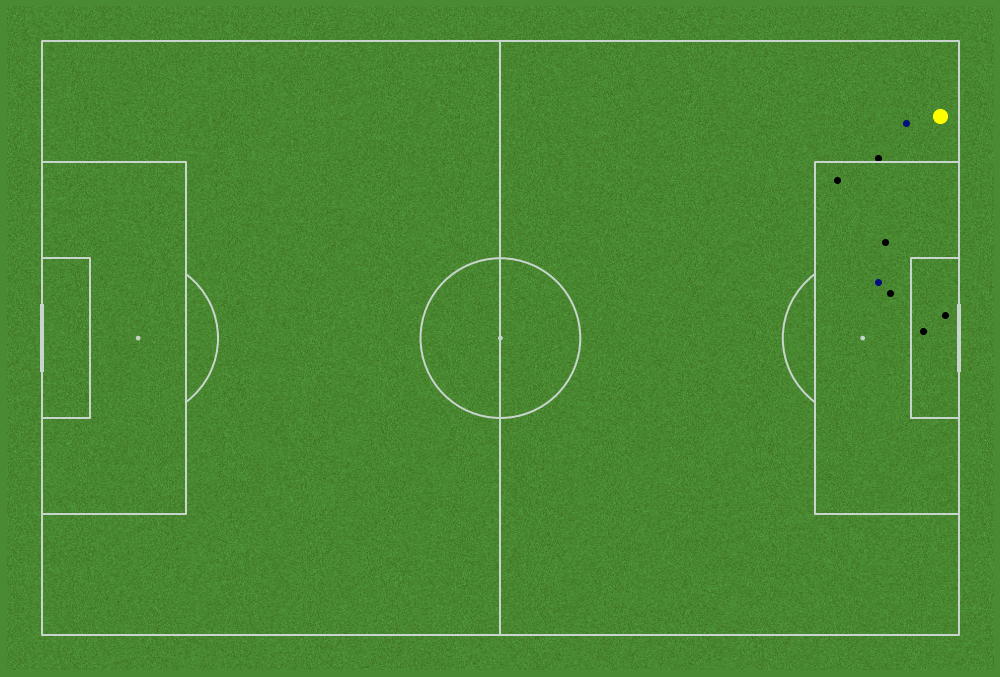

...

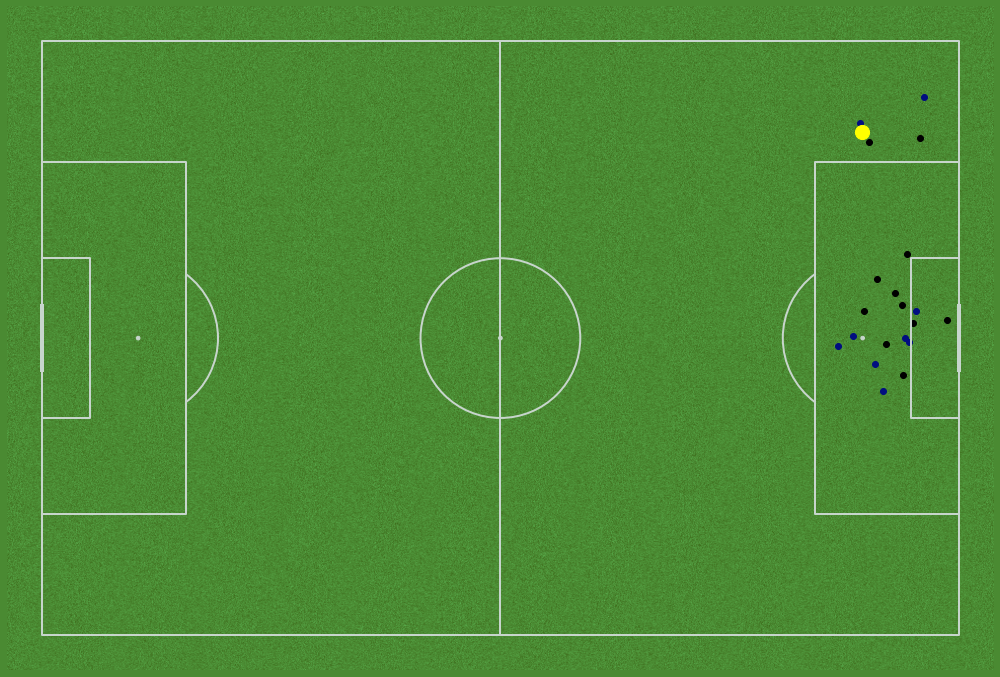

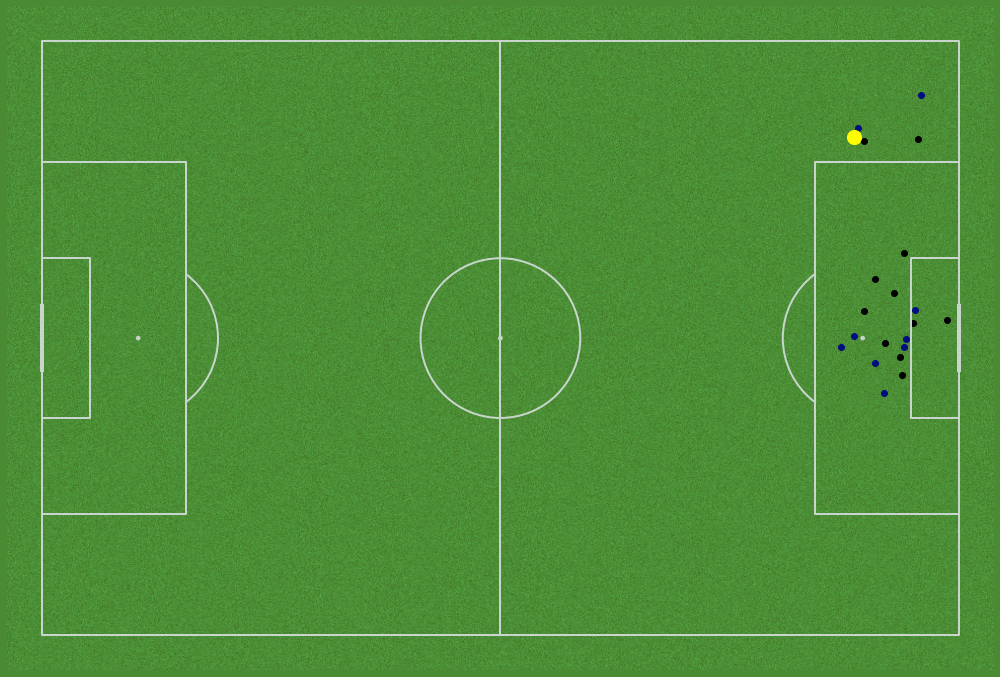

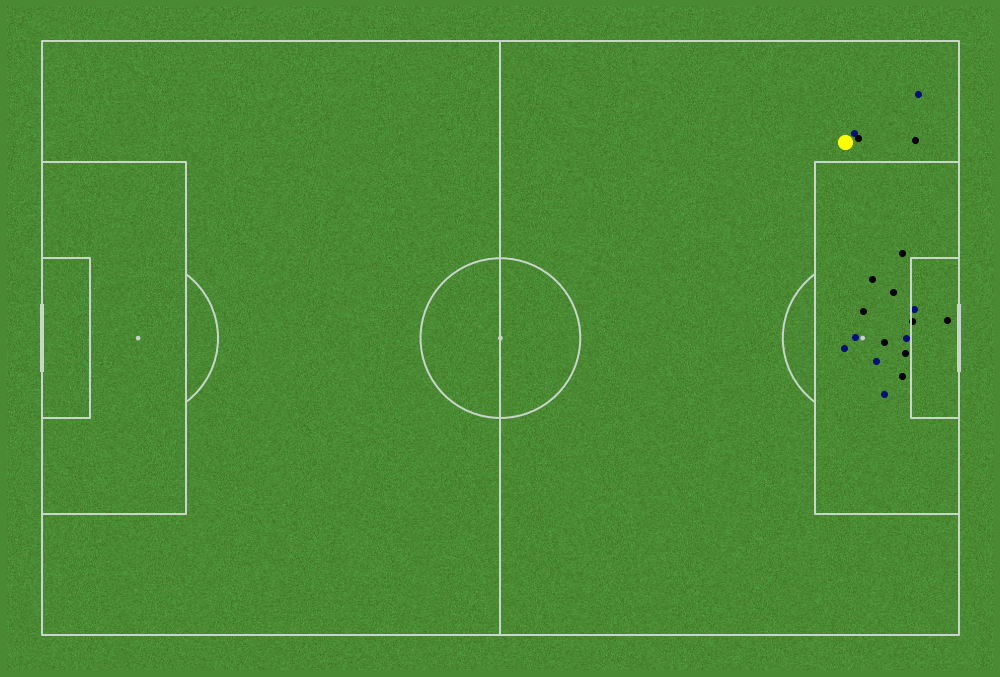

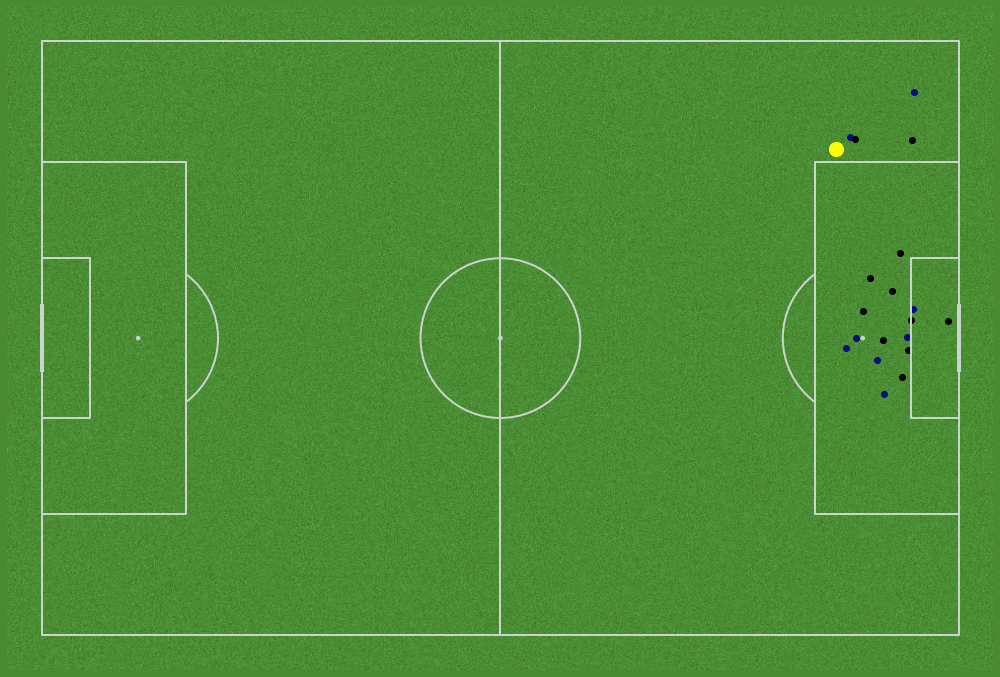

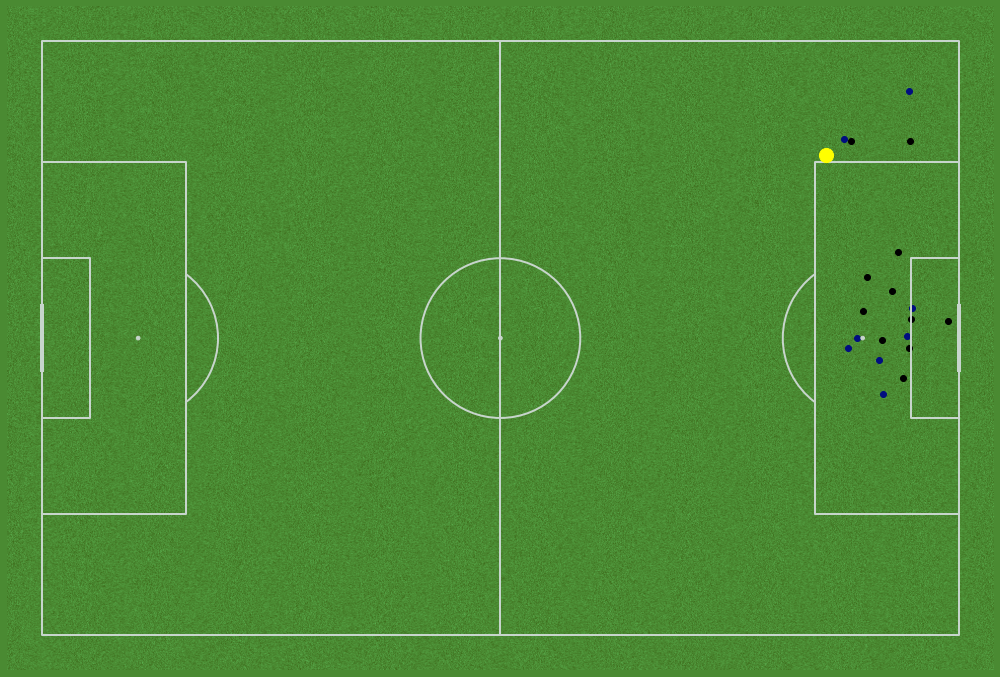

In [399]:
from highlight_text import ax_text

hfont = {'fontname':'Georgia'}


count = 0


for i in range(40):

    list_df = [new_Df.iloc[32413 + i]]

    for df1 in list_df:
    # df = list_df[215] 
        pitch = Pitch(pitch_color='grass',pitch_type='custom',  # example plotting a tracab pitch
              pitch_length=105, pitch_width=68,figsize=(14, 12), line_zorder=2, line_color='#c7d5cc')

        fig, ax = pitch.draw(figsize=(14, 12))

        fig.set_facecolor('#4a8a32')

    #     for x in range(len(df['ball_x'])):

        home_x_cols = [col for col in df1.index if col.startswith('home_') and col.endswith('_x')]
        home_y_cols = [col for col in df1.index if col.startswith('home_') and col.endswith('_y')]

        away_x_cols = [col for col in df1.index if col.startswith('away_') and col.endswith('_x')]
        away_y_cols = [col for col in df1.index if col.startswith('away_') and col.endswith('_y')]

        # Extract the x and y values
        x_values = df1[home_x_cols]
        y_values = df1[home_y_cols]


        x_values_a = df1[away_x_cols]
        y_values_a = df1[away_y_cols]

        # Plot the scatter plot
        plt.scatter(x_values, 68 - y_values, color = "#010E80")

        plt.scatter( x_values_a,68 - y_values_a, color = "black")


        # plt.scatter(15, color = "red")

        # if int(df1['ball_owning_team_id']) == 145:
        #     color = "#010E80"
        #     size = 270
        # elif int((df1['ball_owning_team_id']) == 139):
        #     color = "black"
        #     size = 270
        # elif((df1['ball_owning_team_id']) == 1):
        #     color = "#fbb800"
        #     size = 100
        # else:
        #     color = "red"
        #     size = 270

        plt.scatter( df1['ball_x'],68 - df1['ball_y'],color="yellow",marker="o",s=200,zorder=3)


        # plt.scatter( 0,68,color="orange",marker="o",s=200,zorder=3)

        # plt.annotate()
    #     if (df['team_id'][x] == 145) | (df['team_id'][x] == 139):
    #         pitch.annotate(int(df['jersey'][x]), xy=(120-df['x'][x], df['y'][x]), c='white', va='center', ha='center', size=8, weight='bold', ax=ax,zorder=3)

        # ax.invert_yaxis()  

        '''
        plt.text(125,3,"Tracking Data by Skill Corner",**hfont,color="white",size=17)

        plt.text(125,53,"Timestamp: "+ str(df1['formatted_time']),**hfont,color="white",size=17)


        plt.text(129,25,"Juventus vs Inter Milan",**hfont,color="white",size=21)


        #Juve
        plt.scatter(122,4,color='black',marker="o",s=100)
        plt.text(121,6,"Juventus",**hfont,color="white",size=21)

        #Inter
        plt.scatter(122,26,color='#010E80',marker="o",s=100)
        plt.text(121,28,"Inter Milan",**hfont,color="white",size=21)

        #Ref
        plt.scatter(122,50,color='#fbb800',marker="o",s=100)
        plt.text(121,52,"Referee",**hfont,color="white",size=21)


        #Ball
        plt.scatter(122,68,color='red',marker="o",s=100)
        plt.text(121,70,"Ball",**hfont,color="white",size=21)



        plt.text(134,30,'Seria A 19-20',**hfont,color="#aaffc3",size=25)
        ax.text(-3,15,"Twitter: @simplywink",color="white",ha="center",va="center",fontsize=15)
        '''


    # plt.savefig('this' + str(i) + '.png',dpi=600,bbox_inches='tight',facecolor='#4a8a32')
    

In [388]:
import numpy as np

def is_within_radius(x, y, corner_x, corner_y, radius):
    distance = np.sqrt((x - corner_x)**2 + (y - corner_y)**2)
    return np.isclose(distance, radius, atol=0.1)

radius = 1  # 1-meter radius

mask_nan = df[["ball_x", "ball_y"]].isnull().any(axis=1)  # Mask for rows with NaN in ball_x or ball_y
mask_on_perimeter = (is_within_radius(df["ball_x"], df["ball_y"], 0, 0, radius) |
                     is_within_radius(df["ball_x"], df["ball_y"], 105, 0, radius) |
                     is_within_radius(df["ball_x"], df["ball_y"], 0, 68, radius) |
                     is_within_radius(df["ball_x"], df["ball_y"], 105, 68, radius))

df_filtered_per = df[~(mask_nan | ~mask_on_perimeter)]


In [389]:
df_filtered_per

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
5427,1,919,11024,None,145.0,106.354784,0.374605,NaN,94.354498,30.687274,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5428,1,919,11025,None,145.0,105.508144,0.343786,NaN,94.294482,31.226605,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5430,1,919,11027,None,145.0,104.425570,0.265147,NaN,94.339217,31.833537,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5431,1,919,11028,None,145.0,104.294437,0.250424,NaN,93.741735,32.770635,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5432,1,919,11029,None,145.0,104.459776,0.251098,NaN,92.960981,33.968400,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5437,1,920,11034,None,145.0,104.613229,0.342592,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:20
5438,1,920,11035,None,145.0,104.595914,0.355071,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:20
5443,1,920,11040,None,145.0,104.625824,0.350002,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:20
5444,1,920,11041,None,145.0,104.622326,0.334853,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:20
5454,1,921,11051,None,145.0,104.593855,0.335735,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:21


In [180]:
df_filtered_per.columns

Index(['period_id', 'timestamp', 'frame_id', 'ball_state',
       'ball_owning_team_id', 'ball_x', 'ball_y', 'ball_z', 'home_37_x',
       'home_37_y',
       ...
       'away_anon_10663_s', 'away_anon_10674_x', 'away_anon_10674_y',
       'away_anon_10674_d', 'away_anon_10674_s', 'away_anon_10673_x',
       'away_anon_10673_y', 'away_anon_10673_d', 'away_anon_10673_s',
       'formatted_time'],
      dtype='object', length=2537)

In [390]:
import numpy as np

def is_within_radius(x, y, corner_x, corner_y, radius):
    distance = np.sqrt((x - corner_x)**2 + (y - corner_y)**2)
    return np.isclose(distance, radius, atol=0.5)

radius = 1  # 1-meter radius

mask_nan = new_Df[["ball_x", "ball_y"]].isnull().any(axis=1)  # Mask for rows with NaN in ball_x or ball_y
mask_on_perimeter = (is_within_radius(new_Df["ball_x"], new_Df["ball_y"], 0, 0, radius) |
                     is_within_radius(new_Df["ball_x"], new_Df["ball_y"], 105, 0, radius) |
                     is_within_radius(new_Df["ball_x"], new_Df["ball_y"], 0, 68, radius) |
                     is_within_radius(new_Df["ball_x"], new_Df["ball_y"], 105, 68, radius))

new_Df[~(mask_nan | ~mask_on_perimeter)]


,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
5427,1,919,11024,None,145.0,106.354784,0.374605,NaN,94.354498,30.687274,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5428,1,919,11025,None,145.0,105.508144,0.343786,NaN,94.294482,31.226605,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5430,1,919,11027,None,145.0,104.425570,0.265147,NaN,94.339217,31.833537,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5431,1,919,11028,None,145.0,104.294437,0.250424,NaN,93.741735,32.770635,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5432,1,919,11029,None,145.0,104.459776,0.251098,NaN,92.960981,33.968400,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5437,1,920,11034,None,145.0,104.613229,0.342592,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:20
5438,1,920,11035,None,145.0,104.595914,0.355071,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:20
5443,1,920,11040,None,145.0,104.625824,0.350002,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:20
5444,1,920,11041,None,145.0,104.622326,0.334853,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:20
5454,1,921,11051,None,145.0,104.593855,0.335735,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:21


In [360]:
import numpy as np

def is_within_radius(x, y, corner_x, corner_y, radius):
    distance = np.sqrt((x - corner_x)**2 + (y - corner_y)**2)
    return distance <= radius

radius = 1  # 1-meter radius

mask_nan = new_Df[["ball_x", "ball_y"]].isnull().any(axis=1)  # Mask for rows with NaN in ball_x or ball_y
mask_within_radius = ~(is_within_radius(new_Df["ball_x"], new_Df["ball_y"], 0, 0, radius) |
                       is_within_radius(new_Df["ball_x"], new_Df["ball_y"], 105, 0, radius) |
                       is_within_radius(new_Df["ball_x"], new_Df["ball_y"], 0, 68, radius) |
                       is_within_radius(new_Df["ball_x"], new_Df["ball_y"], 105, 68, radius))

try_df = new_Df[~(mask_nan | mask_within_radius)]


In [400]:
try_df

,period_id,timestamp,frame_id,ball_state,ball_owning_team_id,ball_x,ball_y,ball_z,home_37_x,home_37_y,...,away_anon_10663_s,away_anon_10674_x,away_anon_10674_y,away_anon_10674_d,away_anon_10674_s,away_anon_10673_x,away_anon_10673_y,away_anon_10673_d,away_anon_10673_s,formatted_time
5428,1,919,11025,None,145.0,105.508144,0.343786,NaN,94.294482,31.226605,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5429,1,919,11026,None,145.0,104.790587,0.299539,NaN,94.597591,31.192247,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5430,1,919,11027,None,145.0,104.425570,0.265147,NaN,94.339217,31.833537,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5431,1,919,11028,None,145.0,104.294437,0.250424,NaN,93.741735,32.770635,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
5432,1,919,11029,None,145.0,104.459776,0.251098,NaN,92.960981,33.968400,...,None,NaN,NaN,None,None,NaN,NaN,None,None,15:19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31878,2,5319,68353,None,145.0,104.791618,67.968977,NaN,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,88:39
31879,2,5319,68354,None,145.0,104.824298,68.086746,-0.070692,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,88:39
31880,2,5319,68355,None,145.0,104.874261,68.012861,-0.065373,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,88:39
31881,2,5319,68356,None,145.0,104.982067,67.771179,0.262150,NaN,NaN,...,None,NaN,NaN,None,None,NaN,NaN,None,None,88:39
